1. Define the model

In [7]:
import torch
from torchvision import models, transforms

# Load a pre-trained ResNet-50 model
model = models.resnet50(pretrained=True)
model.eval()  # Set the model to inference mode

/opt/homebrew/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/homebrew/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

2. Create image to image embeddings

In [119]:
import requests

preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

def image_to_feature_vector(image_url):
    response = requests.get(image_url)
    response.raise_for_status()
    image = Image.open(BytesIO(response.content))

    if image.mode != 'RGB':
        image = image.convert('RGB')

    image_tensor = preprocess(image).unsqueeze(0)
    with torch.no_grad():
        features = model(image_tensor)
    return features.numpy().flatten()

3.1 Trial on a single image

In [121]:
image_url = "https://s-media-cache-ak0.pinimg.com/originals/58/dc/c5/58dcc5617e646ccd77205b4de9e01510.jpg"
embedding = process_and_index_image(image_url)
embedding

array([-2.13268280e+00, -9.35995519e-01, -2.33691788e+00, -2.97132683e+00,
       -2.31772852e+00, -3.03639460e+00, -4.54514408e+00, -8.90022159e-01,
       -2.55934095e+00, -2.52622962e+00, -3.46215415e+00, -1.38279629e+00,
       -1.13316274e+00, -3.26849508e+00, -4.07309198e+00, -3.67329931e+00,
       -8.66410613e-01, -2.33374643e+00, -2.05560970e+00, -2.30556154e+00,
       -6.09792948e+00, -3.92561007e+00, -5.29485083e+00, -2.81862354e+00,
       -4.76624441e+00, -3.73548365e+00, -3.69249821e+00, -2.92288375e+00,
       -3.38168335e+00, -3.22702932e+00, -5.12601376e+00, -2.53710270e+00,
       -4.17802334e+00, -4.85656309e+00, -4.15592813e+00, -5.34946489e+00,
       -3.04565954e+00, -5.09614658e+00, -3.07533336e+00,  2.32806206e-02,
       -9.50756550e-01, -3.13346529e+00, -2.99250126e+00, -2.49416375e+00,
       -3.47079420e+00, -2.04548168e+00, -1.89417109e-01, -2.28386402e+00,
       -3.76120996e+00, -2.80864859e+00, -3.08526921e+00, -3.99370813e+00,
       -1.73472595e+00, -

3.2 Trial on `n` rows of embeddings

In [122]:
import json
import numpy as np 

def extract_image_urls(file_path, max_rows):
    urls = [] 
    with open(file_path, 'r') as file:
        for i, line in enumerate(file):
            if i >= max_rows:
                break
            try:
                data = json.loads(line)
                image_url = data.get('im_url')
                if image_url:
                    urls.append(image_url)
            except json.JSONDecodeError:
                print(f"Error decoding JSON on line {i+1}")
    
    return urls

In [123]:
def get_n_rows_of_embeddings(n=100):
    file_path = '../../data/pinterest/pin_to_img.json'
    max_rows = n
    image_urls = extract_image_urls(file_path, max_rows)
    embeddings = np.array([image_to_feature_vector(path) for path in image_urls])
    return embeddings, image_urls

In [124]:
n = 100

embeddings, image_urls = get_n_rows_of_embeddings(n)

4. Init KNN

In [126]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO

def display_images(image_paths, indices):
    n_images = len(indices)
    
    fig, axs = plt.subplots(1, n_images, figsize=(5 * n_images, 10))
    
    if n_images == 1:
        axs = [axs]
    
    for i, ax in enumerate(axs):
        if image_paths[indices[i]].startswith('http'):
            response = requests.get(image_paths[indices[i]])
            image = Image.open(BytesIO(response.content))
        else:
            image = Image.open(image_paths[indices[i]])
        
        ax.imshow(image)
        ax.axis('off')  # Hide axes ticks
        ax.set_title(f"Image {indices[i]}")

    plt.tight_layout()
    plt.show()

def init_and_perform_knn(embeddings, similar_to, image_paths, n_neighbors=5, metric="cosine", algorithm="auto"):
    norms = np.linalg.norm(embeddings, axis=1, keepdims=True)
    normalized_embeddings = embeddings / norms
    knn = NearestNeighbors(n_neighbors=n_neighbors, algorithm=algorithm, metric=metric).fit(normalized_embeddings)

    distances, indices = knn.kneighbors([normalized_embeddings[similar_to]])

    print("Distances:", distances)
    print("Indices:", indices)

    indices = indices[0]

    print("original image")
    display_images(image_paths, [similar_to])

    print("similar images")
    display_images(image_paths, indices)

Distances: [[0.         0.74599636 0.81613874 0.8170501  0.83887833 0.85386795
  0.8587476  0.86355305 0.86949587 0.8776455  0.88812584 0.8900433
  0.8966428  0.8972508  0.90006757 0.9161322  0.91617453 0.9166877
  0.917589   0.9191957 ]]
Indices: [[ 1 97 96 94 67 19 93 17 76 60 74 16 22 89 91  7 32 58 61 99]]
original image


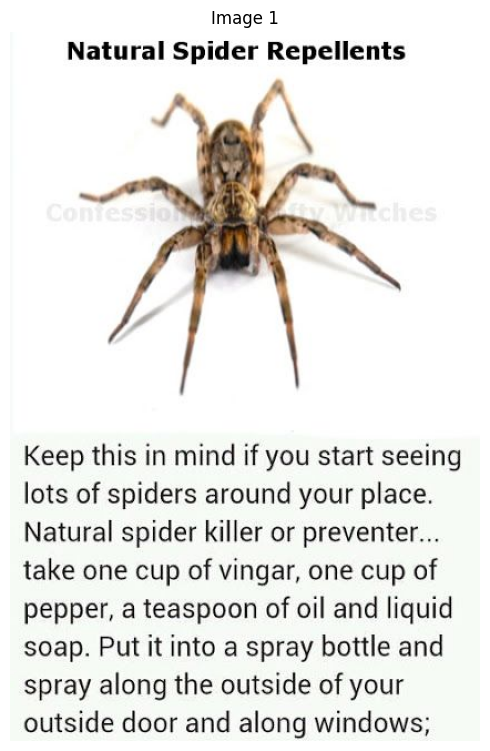

similar images


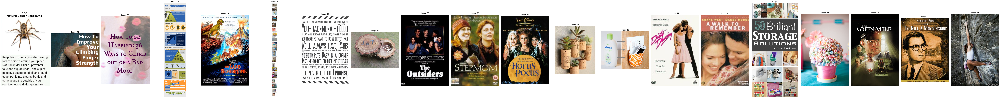

In [127]:
similar_to = 1
init_and_perform_knn(embeddings, similar_to, image_urls, n_neighbors=20, metric="cosine")

Distances: [[0.         0.28130293 0.3057779  0.3075071  0.31289738 0.33050013
  0.34287006 0.3461727  0.34668756 0.34988606 0.35640973 0.35756087
  0.36628258 0.37531912 0.381675   0.3991242  0.40115952 0.4110397
  0.41969812 0.42143792]]
Indices: [[ 0 23 11 53 28 81 44 52 37 64 39 27 13 47 84 85  3 41 36 46]]
original image


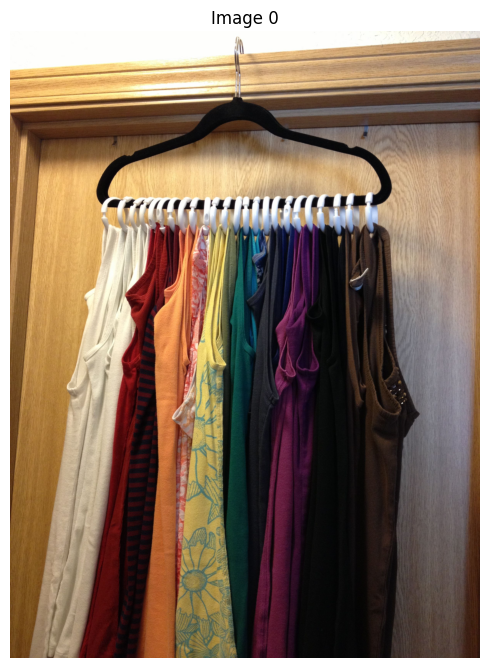

similar images


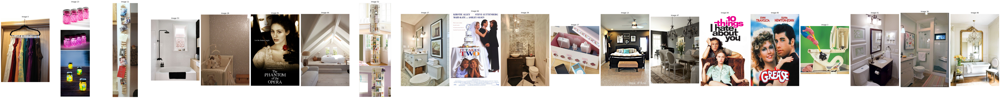

In [129]:
similar_to = 0
init_and_perform_knn(embeddings, similar_to, image_urls, n_neighbors=20, metric="cosine")

5. PCA

TLDR; 5 components seems like a good-ish choice (?), we probably need to do some variance though.

In [130]:
from sklearn.decomposition import PCA

pca = PCA(n_components=5)
reduced_embeddings = pca.fit_transform(embeddings)

Distances: [[0.         0.08651131 0.17401874 0.1918087  0.30164337 0.34547198
  0.38930923 0.39137596 0.43712288 0.4372341 ]]
Indices: [[ 1 97 17 93  5 96 60 99 67 71]]
original image


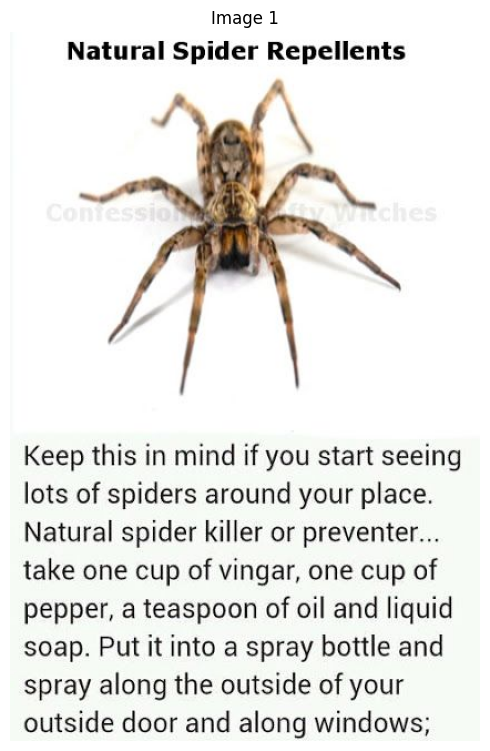

similar images


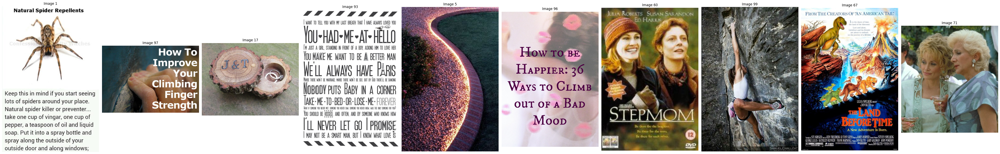

In [131]:
similar_to = 1
init_and_perform_knn(reduced_embeddings, similar_to, image_urls, n_neighbors=10, algorithm="auto")

In [ ]:
def process_and_index_image(image_url):
    feature_vector = image_to_feature_vector(image_url)
    return feature_vector
    
    # # Assume you have a function to index this in Elasticsearch
    # index_image_features_in_es(image_url, feature_vector)